In [1]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import tensorflow as tf
from tensorflow.keras.preprocessing import image as kimage
from tensorflow.keras.applications.vgg16 import preprocess_input
import matplotlib
import matplotlib.pyplot as plt
import os
from PIL import Image
from enum import Enum
import time

# Download Stored Files

In [ ]:
# Download .csv files
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/ImgPaths.csv ImgPaths.csv
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/Text_Labels.csv Text_Labels.csv

In [ ]:
# Download Model files
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/feature_extraction_weights.h5 feature_extraction_weights.h5
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/model_imagerv.h5 model_imagerv.h5

In [ ]:
# Download numpy files saved
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/data_features_train.npy data_features_train.npy
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/VGG16_data_features.npy VGG16_data_features.npy

In [ ]:
# Download dataset zip files
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/query.zip query.zip
!wget https://vprofile-duypham33.s3.amazonaws.com/imageRetrieval/dataset.zip dataset.zip

# Model Preparation

## Load feature extraction weights

In [40]:
img_height = img_width = 160

In [41]:
# Construct layers trained in the 'Training' part
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.2),
])

preprocess_input = tf.keras.applications.vgg16.preprocess_input

base_model = tf.keras.applications.VGG16(input_shape=(img_height,img_width,3),
                                               include_top=False,
                                               weights='imagenet')
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()


In [42]:
inputs = tf.keras.Input(shape=(img_height,img_width,3))
x = data_augmentation(inputs)
x = preprocess_input(x)
outputs = base_model(x)

feature_extract_model = tf.keras.Model(inputs, outputs)
feature_extract_model.compile(tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])


In [43]:
# Load weights trained and saved in the 'Training' part
feature_extract_model.load_weights("feature_extraction_weights.h5")

## Load numpy data feature of trained model

In [13]:
data_features_load = np.load("data_features_train.npy", allow_pickle=True)
data_features_load.shape

(28575, 12800)

## Load trained Model

In [44]:
# Construct the layers of the model trained in the 'Training' part
inputs = tf.keras.Input(shape=(img_height,img_width,3))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.25)(x)
x = tf.keras.layers.Dense(units=512, activation='relu')(x)
x = tf.keras.layers.Dense(units=256, activation='relu')(x)
outputs = tf.keras.layers.Dense(units=134, activation='softmax')(x)

trained_model = tf.keras.Model(inputs, outputs)

# Load weights saved in the 'Training' part
trained_model.load_weights('model_imagerv.h5')
trained_model.compile(tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])


## Load VGG16 Feature Extraction

In [45]:
# Original VGG16 (we used it as a secondary model to enhance the performance)
VGG16_feature_extraction = tf.keras.applications.VGG16(include_top=False,
                                    weights='imagenet',
                                    input_shape=(86, 128, 3))

In [46]:
data_features_load2 = np.load("VGG16_data_features.npy", allow_pickle=True)
data_features_load2.shape

(28575, 4096)

# Prediction

## Prediction Functions

In [47]:
# Load text labels
text_labels = pd.read_csv('Text_Labels.csv', usecols = ['Text_Label'])
# Load image paths of our images for displaying them
img_paths = pd.read_csv('ImgPaths.csv', usecols = ['ImgPath'])

TOTAL_IMAGES = 28575

In [49]:
from collections import OrderedDict

# sort
def getKey(item):
    return item[0]

# Re-format the text label for displayment
def reformat_text(text_label):
  if text_label is None:
    return None
  return (' ').join(map(lambda x: x.capitalize() , text_label.split('_')))

# Compute cosine similarities between the query image and our data features
# Version 1: using trained model
def get_sims1(query_np, num_imgs, weight = 1.0):
  query_np1 = tf.image.resize(query_np, (img_height, img_width))
  query_np1 = np.expand_dims(query_np1, axis=0)
  query_feature1 = feature_extract_model.predict(query_np1) # Get the query's extracted feature
  query_feature1 = np.reshape(query_feature1, (1,-1))

  y_pred = trained_model.predict(query_np1)  # Get predicted label
  label = int(np.argmax(y_pred, axis = 1))
  text_label = text_labels.iloc[label]["Text_Label"].split('.')[0]

  # Compute cosine similarities
  sims1 = weight * cosine_similarity(query_feature1, data_features_load).squeeze()
  indices = [i for i in range(TOTAL_IMAGES)]
  tps1 = zip(sims1.tolist(), indices)
  return sorted(tps1, key=getKey, reverse=True)[:num_imgs], text_label

# Version 2: using original VGG16
def get_sims2(query_np, num_imgs, weight = 1.0):
  query_np2 = np.expand_dims(query_np, axis=0)
  query_np2 = preprocess_input(query_np2)
  query_features2 = VGG16_feature_extraction.predict(query_np2) # Get the query's extracted feature
  query_features2 = np.reshape(query_features2, (1,-1))

  # Compute cosine similarities
  sims2 = weight * cosine_similarity(query_features2, data_features_load2).squeeze()
  indices = [i for i in range(TOTAL_IMAGES)]
  tps2 = zip(sims2.tolist(), indices)
  return sorted(tps2, key=getKey, reverse=True)[:num_imgs]

# Model tuning
class ModelOption(Enum):
  TRAINED = "Trained"
  VGG16 = "Original VGG16"
  HYBRID = "Hybrid"

def get_final_sims(query_np, num_imgs, modelOption = ModelOption.HYBRID, vgg_penalty = 0.85):
  if modelOption == ModelOption.TRAINED:
    tps_sorted, text_label = get_sims1(query_np, num_imgs)
    print("TRAINED")
  elif modelOption == ModelOption.VGG16:
    tps_sorted = get_sims2(query_np, num_imgs)
    text_label = None
    print("VGG16")
  else:
    tps_sorted1, text_label = get_sims1(query_np, num_imgs) # trained version is more important
    tps_sorted2 = get_sims2(query_np, num_imgs, vgg_penalty) # slightly bring version 2 down
    # Hybrid version: mix both versions
    tps_sorted = tps_sorted1 + tps_sorted2
    print(f"MIX: {vgg_penalty}")

  tps_sorted = sorted(tps_sorted, key = getKey, reverse = True)
  tps_sorted = list(map(lambda x: x[1], tps_sorted))
  return list(OrderedDict.fromkeys(tps_sorted))[:num_imgs], reformat_text(text_label)

# Apart from the label predicted from the trained model, we also find the popular label
# among relevant images
def get_popular_label(result_paths, range_num):
  labels = list(map(lambda x: x.split('/')[1], result_paths[:range_num]))
  freq = [labels.count(i) for i in labels]
  return reformat_text(labels[freq.index(max(freq))])

# Get image paths of relevants images
def get_result_paths(tps_sorted):
  return list(map(lambda x: img_paths.iloc[x]['ImgPath'], tps_sorted))


# Evaluation metric
def average_precision(query_path, result_paths):
  label = query_path[(query_path.index('-') + 1):query_path.index('.')]
  precisions = [int(path.split('/')[1].split('_')[1].lower() == label) for path in result_paths]

  num_precisions = 0
  sum_precisions = 0
  for k in range(1, len(precisions) + 1):
    if precisions[k - 1] == 1:
      num_precisions += 1
      precisionAtK = num_precisions / k
      sum_precisions += precisionAtK

  return sum_precisions / num_precisions if num_precisions > 0 else 0.0


In [50]:
# Search and plot
def search_img(query_path, num_imgs, range_popular = 20, modelOption = ModelOption.HYBRID, vgg_penalty = 0.85):
  # Load query image from its path
  query = kimage.load_img(query_path, target_size=(86, 128))
  plt.figure(figsize=(8, 8))
  plt.axis('off')
  plt.imshow(Image.open(query_path))

  query_np = kimage.img_to_array(query) # Convert to array
  tps_sorted, text_label = get_final_sims(query_np, num_imgs, modelOption, vgg_penalty) # Get relevants

  result_paths = get_result_paths(tps_sorted) # Get image paths of relevants images
  # Evaluate
  map = round(average_precision(query_path, result_paths), 3)

  # Get the popular label among relevant images
  popular_text_label = get_popular_label(result_paths, range_num = range_popular)
  plt.title(f'Using {modelOption.value} model{f" with vgg_penalty={vgg_penalty}" if modelOption == ModelOption.HYBRID else ""}')

  # Plot
  fig = plt.figure(figsize=(8,8))
  plt.title(f'Precision: {map}, Popular: {popular_text_label}, Model predicted: {text_label}')
  plt.axis('off')
  columns = 4
  rows = num_imgs // 4 if num_imgs % 4 == 0 else (num_imgs // 4 + 1)
  for i in range(1, num_imgs + 1):
      img = Image.open(result_paths[i-1])
      fig.add_subplot(rows, columns, i)

      plt.axis('off')
      plt.imshow(img)

  return result_paths, popular_text_label, text_label


def search_imgWithAllOpts(query_path, num_imgs, range_popular = 20, vgg_penalty = 0.85):
  # Load query image from its path
  query = kimage.load_img(query_path, target_size=(86, 128))
  modelOptions = [ModelOption.TRAINED, ModelOption.VGG16, ModelOption.HYBRID]

  num_imgs = num_imgs + (4 - num_imgs) % 4 # make it divisible by 4 for ploting
  results = [get_final_sims(kimage.img_to_array(query), num_imgs, modelOption=modelOption, vgg_penalty=vgg_penalty) for modelOption in modelOptions]

  # Get image paths of relevants images
  result_paths_list = [get_result_paths(tps_sorted) for (tps_sorted, _) in results]

  # Evaluate
  map_list = [round(average_precision(query_path, result_paths), 3) for result_paths in result_paths_list]

  # Get the popular label among relevant images
  popular_text_label = [get_popular_label(result_paths, range_num = range_popular) for result_paths in result_paths_list]

  fig = plt.figure(figsize=(20, 8))
  for i in range(3):
    modelOption = modelOptions[i]
    fig.add_subplot(1, 3, i + 1)
    plt.axis('off')
    plt.title(f'Using {modelOption.value} model{f" with vgg_penalty={vgg_penalty}" if modelOption == ModelOption.HYBRID else ""}')
    plt.imshow(Image.open(query_path))

  fig = plt.figure(figsize=(24,8))
  columns = 12
  rows = num_imgs // 4 if num_imgs % 4 == 0 else (num_imgs // 4 + 1)
  for row in range(rows):
    i = row * 4
    row_paths = result_paths_list[0][i:(i+4)] + result_paths_list[1][i:(i+4)] + result_paths_list[2][i:(i+4)]
    for j in range(1, 13):
      img = Image.open(row_paths[j-1])
      fig.add_subplot(rows, columns, 12 * row + j)
      if i == 0 and j in [3, 7, 11]:
        k = (j - 3) // 4
        plt.title(f'Precision: {map_list[k]}, Popular: {popular_text_label[k]}, Model predicted: {results[k][1]}')

      plt.axis('off')
      plt.imshow(img)



## Example Prediction

In [21]:
import os
os.listdir()

['.config',
 'VGG16_data_features.npy',
 'dataset.zip',
 'Text_Labels.csv',
 'index.html',
 'ImgPaths.csv',
 'feature_extraction_weights.h5',
 'data_features_train.npy',
 'model_imagerv.h5',
 'query.zip',
 'sample_data']

In [23]:
!unzip 'query.zip'

Archive:  query.zip
   creating: query/
  inflating: query/query1-alligator.png  
  inflating: query/query10-waterfall.PNG  
  inflating: query/query11-waterfall.jpg  
  inflating: query/query12-umbrella.PNG  
  inflating: query/query13-ants.jpg  
  inflating: query/query14-panda.jpg  
  inflating: query/query15-shrimp.jpg  
  inflating: query/query16-fridge.png  
  inflating: query/query17-panda.jpg  
  inflating: query/query18-wheat.png  
  inflating: query/query19-lantana.jpg  
  inflating: query/query2-clock.PNG  
  inflating: query/query20-river.jpg  
  inflating: query/query21-cart.jpg  
  inflating: query/query3-apricot.PNG  
  inflating: query/query4-grassland.PNG  
  inflating: query/query5-glacier.PNG  
  inflating: query/query6-fern.jpg   
  inflating: query/query7-piano.jpg  
  inflating: query/query8-lake.png   


In [51]:
%cd query

/content/query


In [31]:
# Unzip image dataset
!unzip '/content/dataset.zip'

Streaming output truncated to the last 5000 lines.
  inflating: dataset/scenery_river/149.jpg  
  inflating: dataset/scenery_river/265.jpg  
  inflating: dataset/scenery_river/56.jpg  
  inflating: dataset/scenery_river/23.jpg  
  inflating: dataset/scenery_river/222.jpg  
  inflating: dataset/scenery_river/133.jpg  
  inflating: dataset/scenery_river/109.jpg  
  inflating: dataset/scenery_river/41.jpg  
  inflating: dataset/scenery_river/60.jpg  
  inflating: dataset/scenery_river/116.jpg  
  inflating: dataset/scenery_river/225.jpg  
  inflating: dataset/scenery_river/236.jpg  
  inflating: dataset/scenery_river/256.jpg  
  inflating: dataset/scenery_river/32.jpg  
  inflating: dataset/scenery_river/46.jpg  
  inflating: dataset/scenery_river/79.jpg  
  inflating: dataset/scenery_river/98.jpg  
  inflating: dataset/scenery_river/101.jpg  
  inflating: dataset/scenery_river/99.jpg  
  inflating: dataset/scenery_river/47.jpg  
  inflating: dataset/scenery_river/195.jpg  
  inflating: d

1/1 [==============================] - 0s 443ms/step
TRAINED


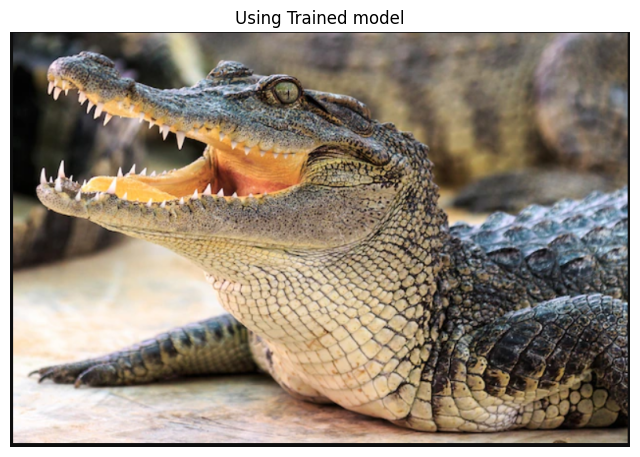

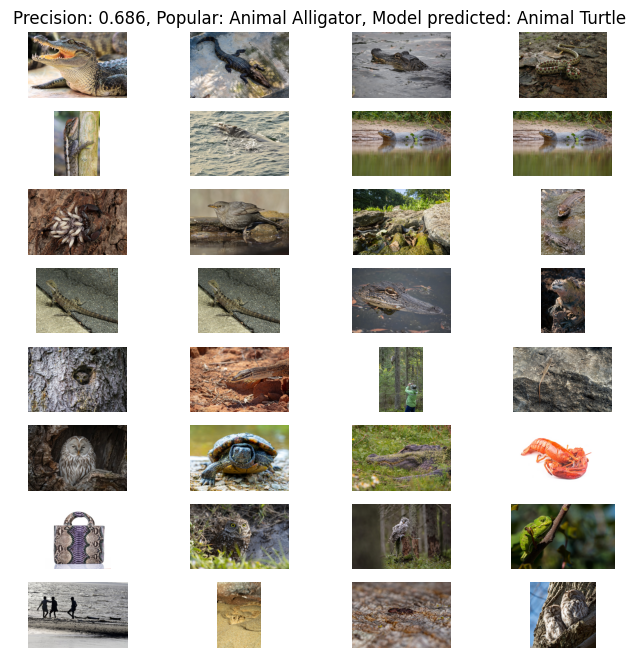

In [32]:
# Our query is an animal alligator
_ = search_img('query1-alligator.png', num_imgs = 32, modelOption = ModelOption.TRAINED, vgg_penalty = 0.95)
# The results look OK!

In [33]:
search_imgWithAllOpts('query1-alligator.png', 20, vgg_penalty = 0.8)

Output hidden; open in https://colab.research.google.com to view.

1/1 [==============================] - 1s 590ms/step
TRAINED
1/1 [==============================] - 0s 231ms/step
VGG16
1/1 [==============================] - 0s 153ms/step
MIX: 0.8


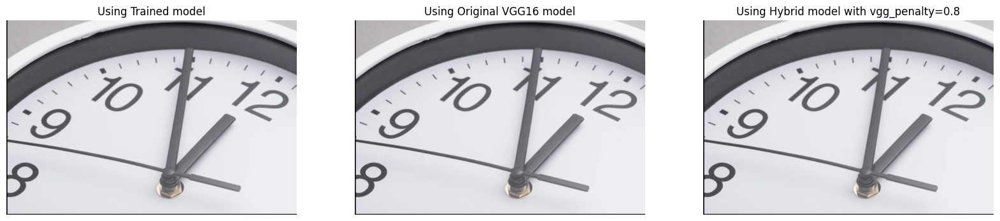

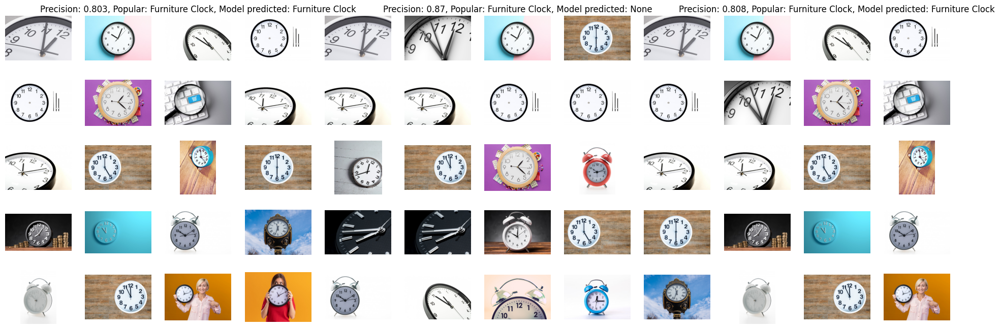

In [ ]:
# Our query is a clock
search_imgWithAllOpts('query2-clock.PNG', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 520ms/step
TRAINED
1/1 [==============================] - 0s 168ms/step
VGG16
1/1 [==============================] - 0s 145ms/step
MIX: 0.8
apricot
[1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0]
K 1: 1.0
K 2: 1.0
K 9: 0.3333333333333333
K 12: 0.3333333333333333
K 15: 0.3333333333333333
K 18: 0.3333333333333333
K 19: 0.3684210526315789
0.5288220551378446
apricot
[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
K 1: 1.0
1.0
apricot
[1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0]
K 1: 1.0
K 2: 1.0
K 9: 0.3333333333333333
K 12: 0.3333333333333333
K 15: 0.3333333333333333
K 18: 0.3333333333333333
K 19: 0.3684210526315789
0.5288220551378446


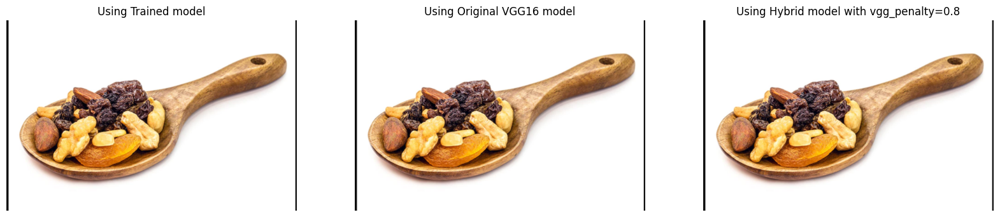

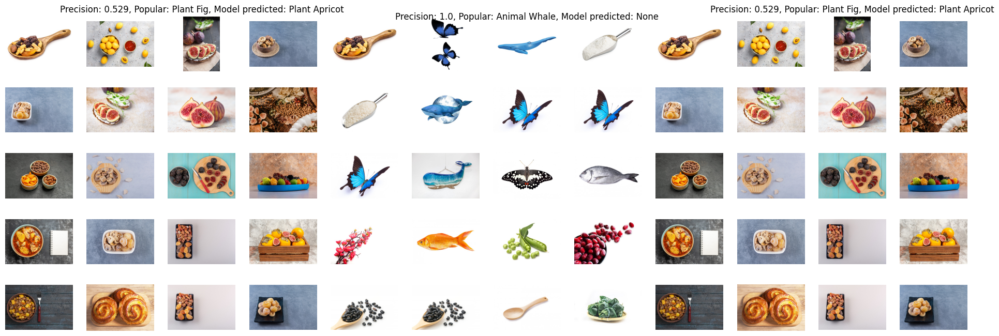

In [ ]:
search_imgWithAllOpts('query3-apricot.PNG', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 561ms/step
TRAINED
1/1 [==============================] - 0s 144ms/step
VGG16
1/1 [==============================] - 0s 245ms/step
MIX: 0.8


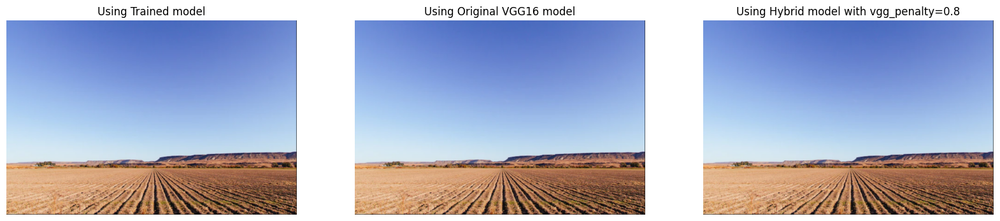

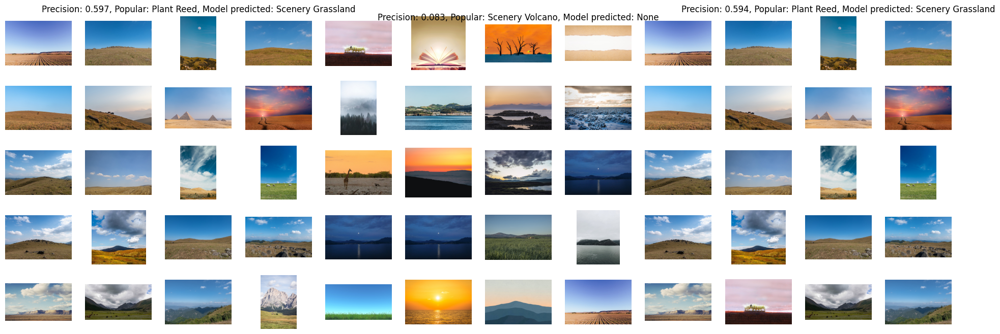

In [ ]:
search_imgWithAllOpts('query4-grassland.PNG', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 1s 927ms/step
TRAINED
1/1 [==============================] - 0s 261ms/step
VGG16
1/1 [==============================] - 0s 144ms/step
MIX: 0.8


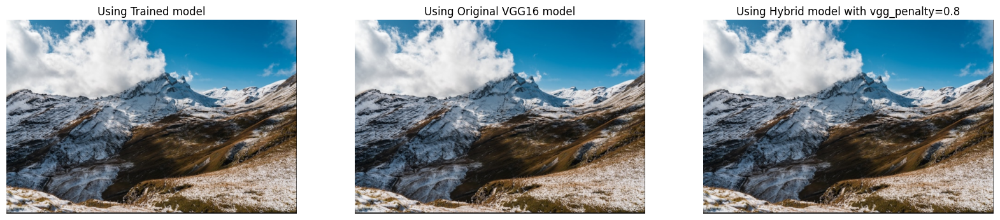

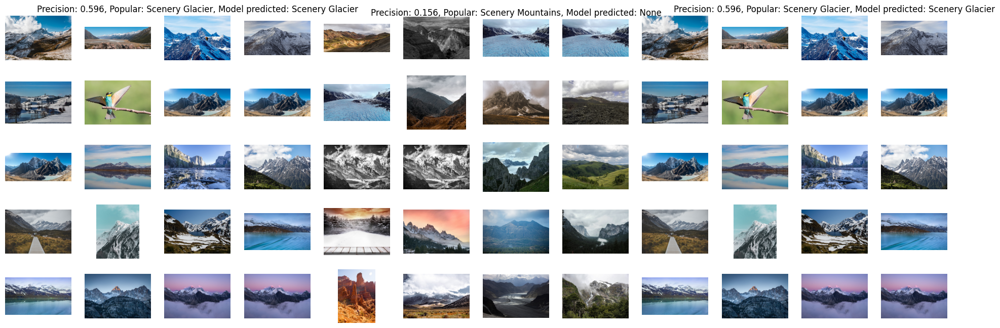

In [ ]:
search_imgWithAllOpts('query5-glacier.PNG', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 0s 293ms/step
TRAINED
1/1 [==============================] - 0s 142ms/step
VGG16
1/1 [==============================] - 0s 154ms/step
MIX: 0.8


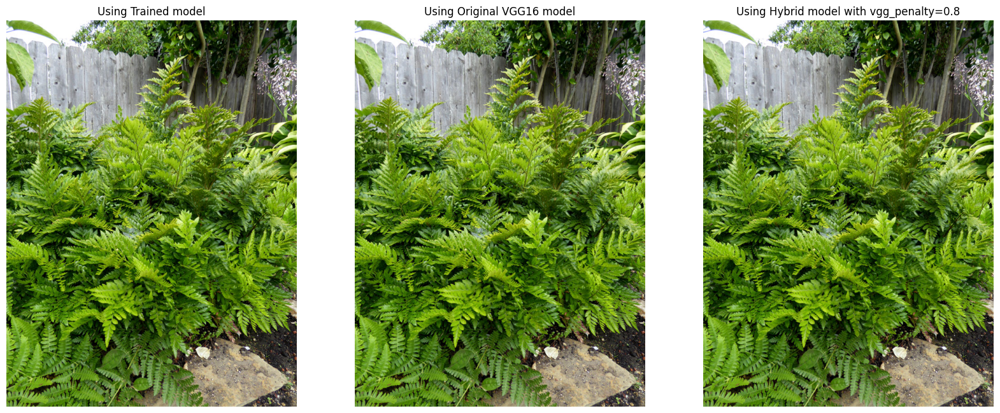

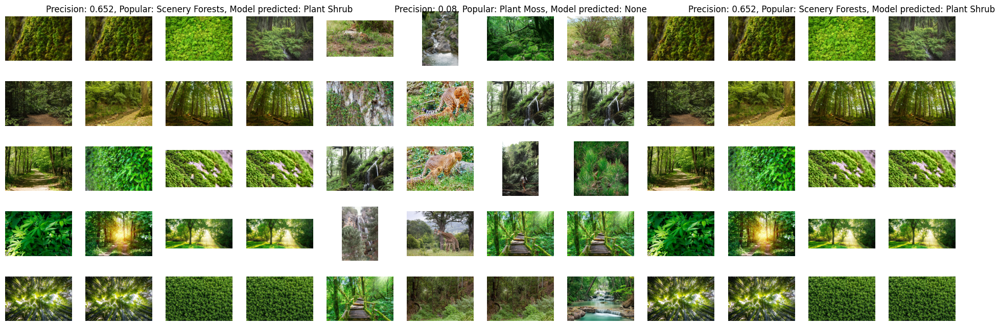

In [ ]:
search_imgWithAllOpts('query6-fern.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 803ms/step
TRAINED
1/1 [==============================] - 0s 161ms/step
VGG16
1/1 [==============================] - 0s 156ms/step
MIX: 0.8


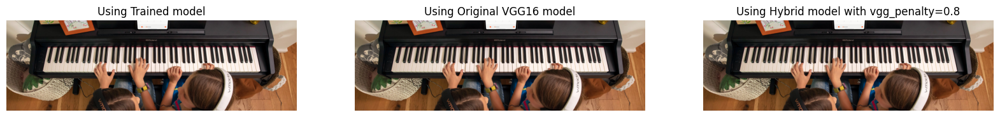

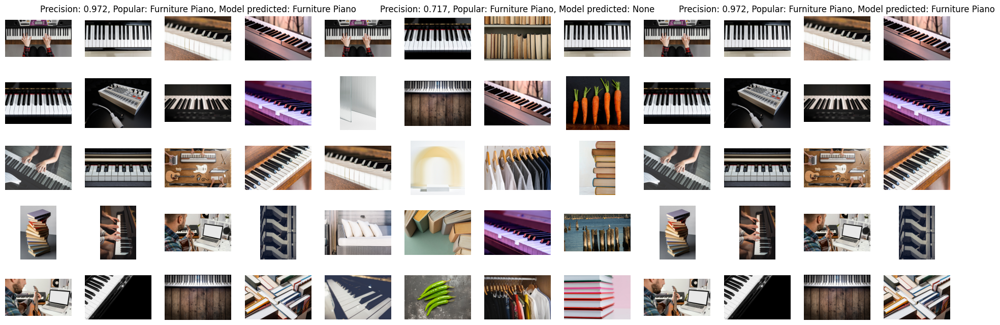

In [ ]:
search_imgWithAllOpts('query7-piano.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 0s 327ms/step
TRAINED
1/1 [==============================] - 0s 165ms/step
VGG16
1/1 [==============================] - 0s 273ms/step
MIX: 0.8


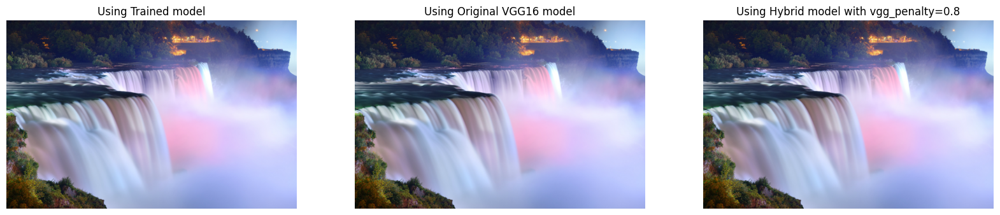

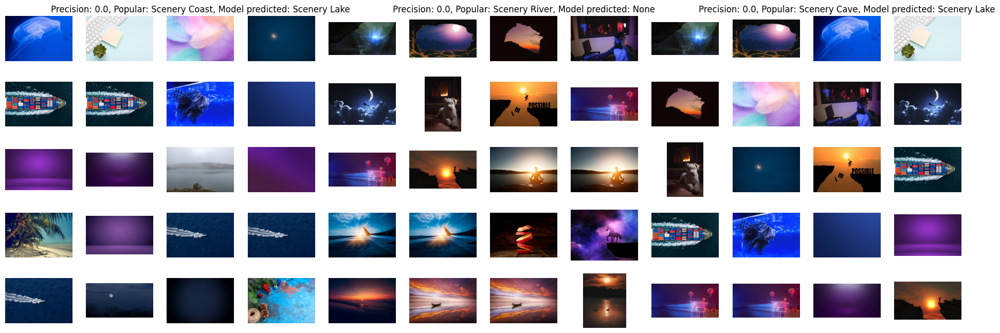

In [ ]:
search_imgWithAllOpts('query8-lake.png', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 1s 640ms/step
TRAINED
1/1 [==============================] - 0s 140ms/step
VGG16
1/1 [==============================] - 0s 144ms/step
MIX: 0.8


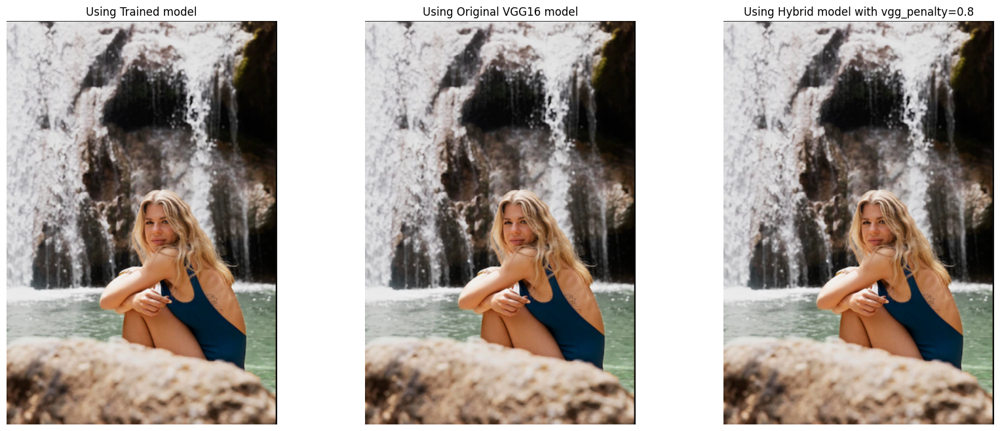

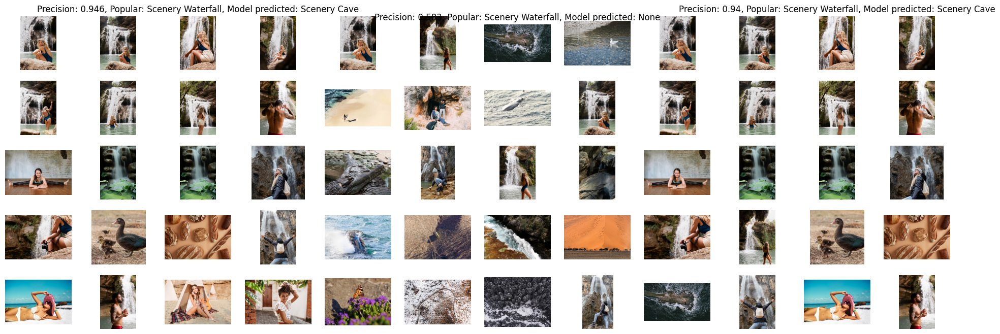

In [ ]:
search_imgWithAllOpts('query10-waterfall.PNG', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 968ms/step
TRAINED
1/1 [==============================] - 0s 169ms/step
VGG16
1/1 [==============================] - 0s 255ms/step
MIX: 0.8


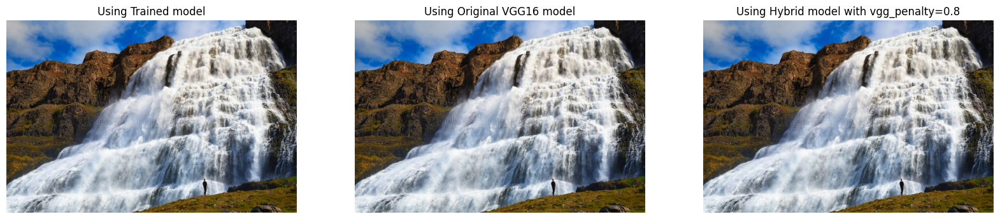

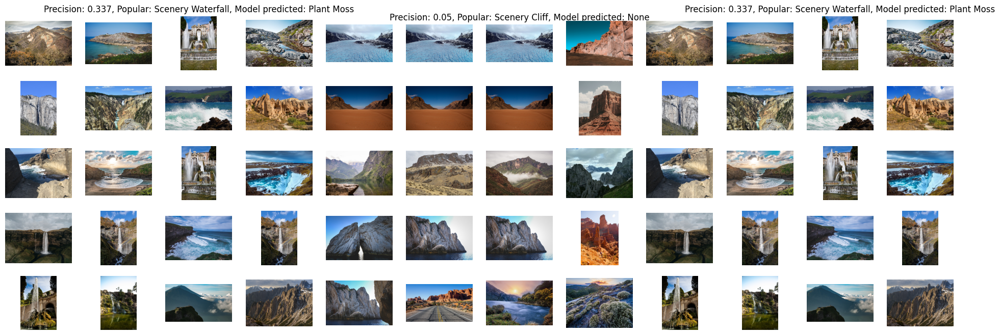

In [ ]:
search_imgWithAllOpts('query11-waterfall.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 897ms/step
TRAINED
1/1 [==============================] - 0s 148ms/step
VGG16
1/1 [==============================] - 0s 148ms/step
MIX: 0.8


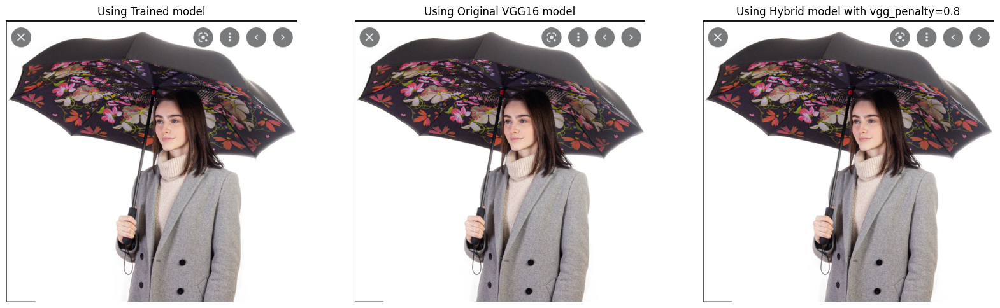

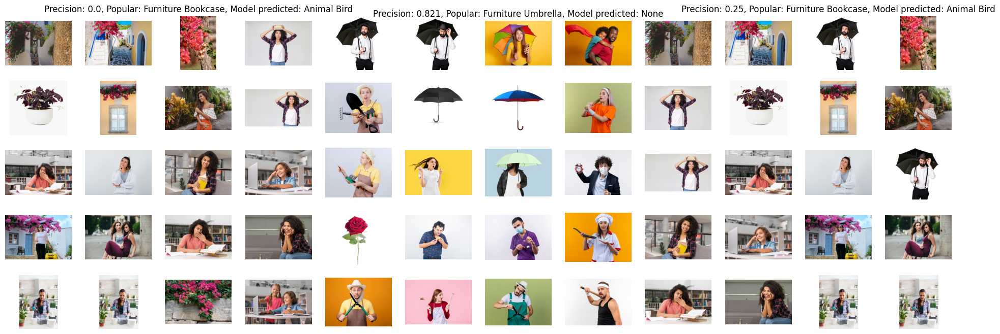

In [ ]:
search_imgWithAllOpts('query12-umbrella.PNG', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 0s 344ms/step
TRAINED
1/1 [==============================] - 0s 149ms/step
VGG16
1/1 [==============================] - 0s 149ms/step
MIX: 0.8


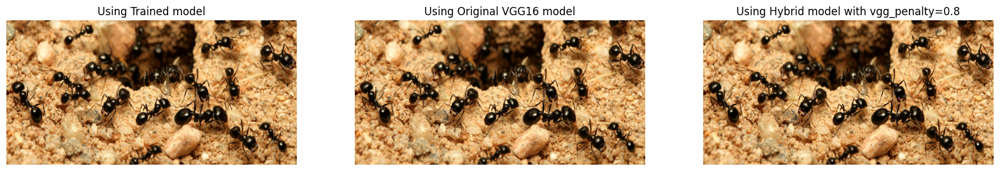

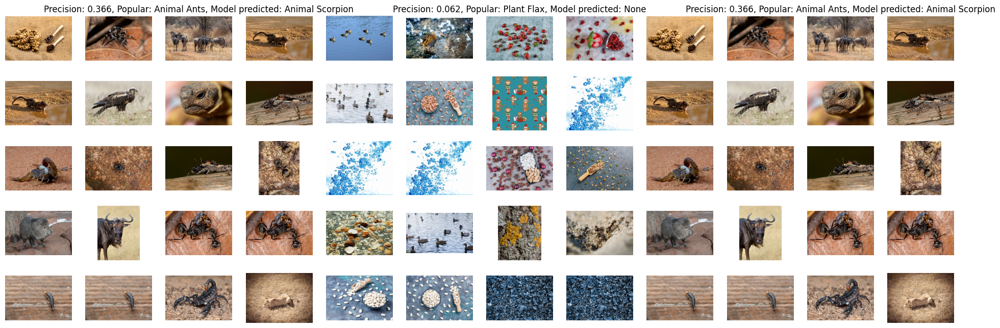

In [ ]:
search_imgWithAllOpts('query13-ants.jpg', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 1s 652ms/step
TRAINED
1/1 [==============================] - 0s 152ms/step
VGG16
1/1 [==============================] - 0s 146ms/step
MIX: 0.8


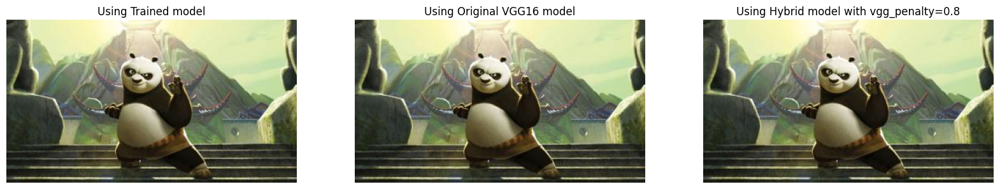

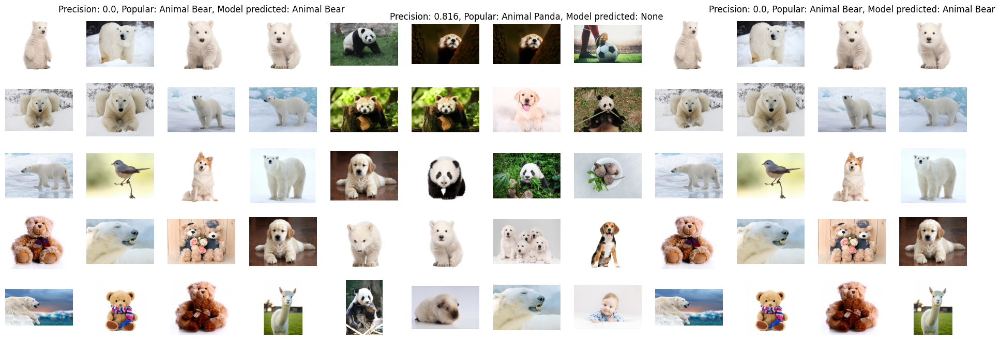

In [ ]:
search_imgWithAllOpts('query14-panda.jpg', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 0s 465ms/step
TRAINED
1/1 [==============================] - 0s 148ms/step
VGG16
1/1 [==============================] - 0s 144ms/step
MIX: 0.8


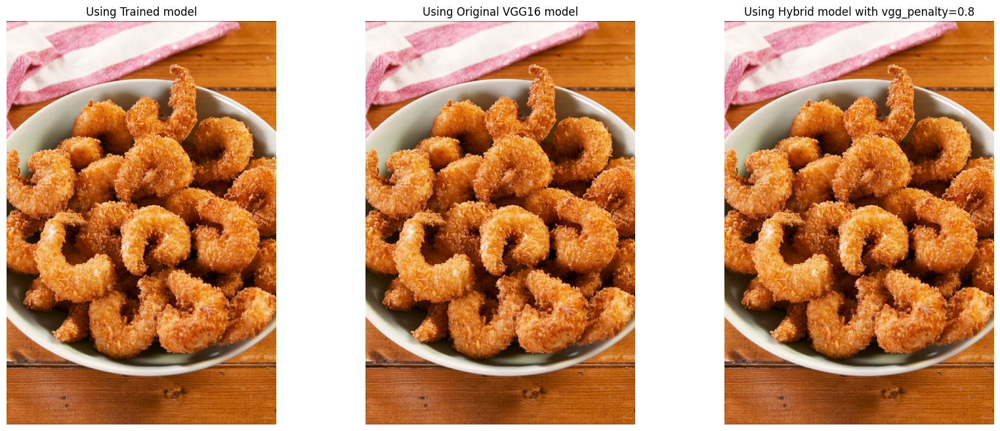

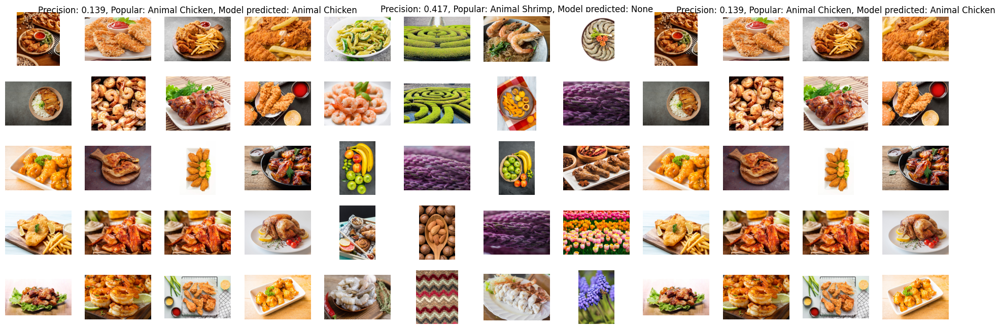

In [ ]:
search_imgWithAllOpts('query15-shrimp.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 0s 314ms/step
TRAINED
1/1 [==============================] - 0s 165ms/step
VGG16
1/1 [==============================] - 0s 152ms/step
MIX: 0.8


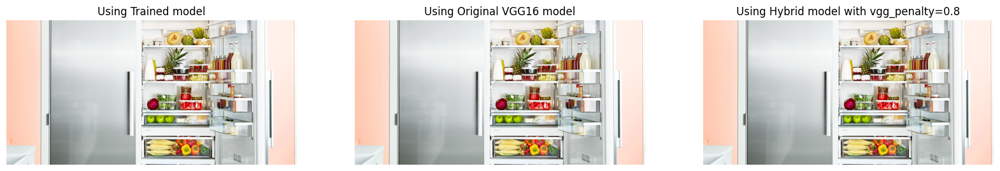

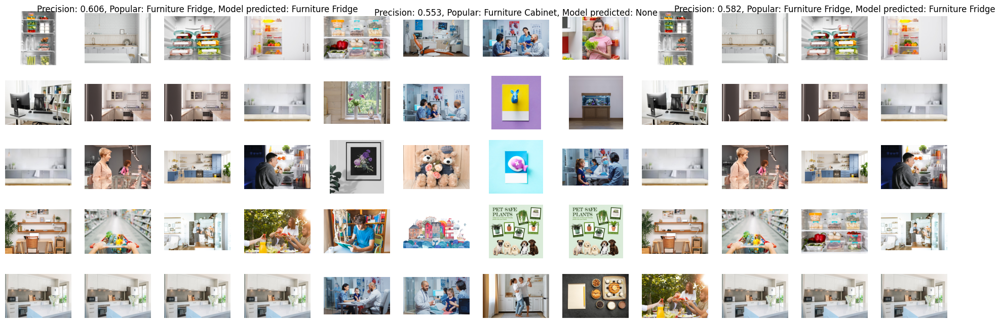

In [ ]:
search_imgWithAllOpts('query16-fridge.png', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 502ms/step
TRAINED
1/1 [==============================] - 0s 266ms/step
VGG16
1/1 [==============================] - 0s 141ms/step
MIX: 0.8


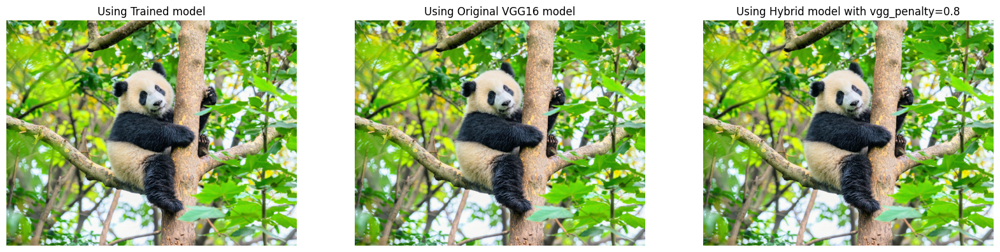

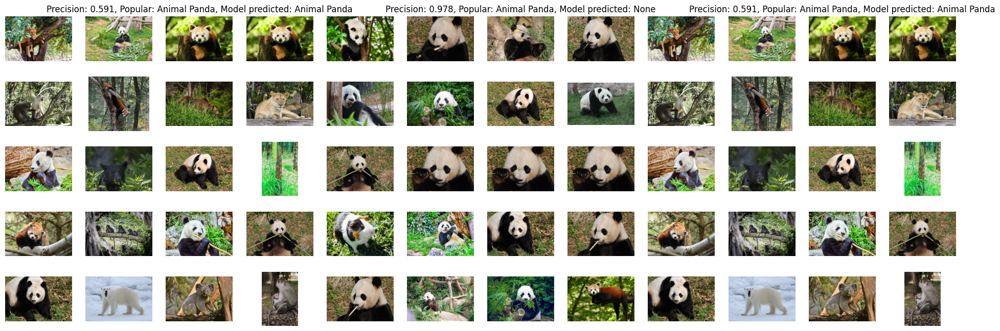

In [ ]:
search_imgWithAllOpts('query17-panda.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 519ms/step
TRAINED
1/1 [==============================] - 0s 160ms/step
VGG16
1/1 [==============================] - 0s 146ms/step
MIX: 0.8


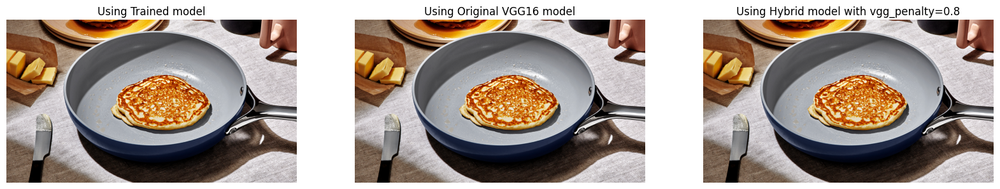

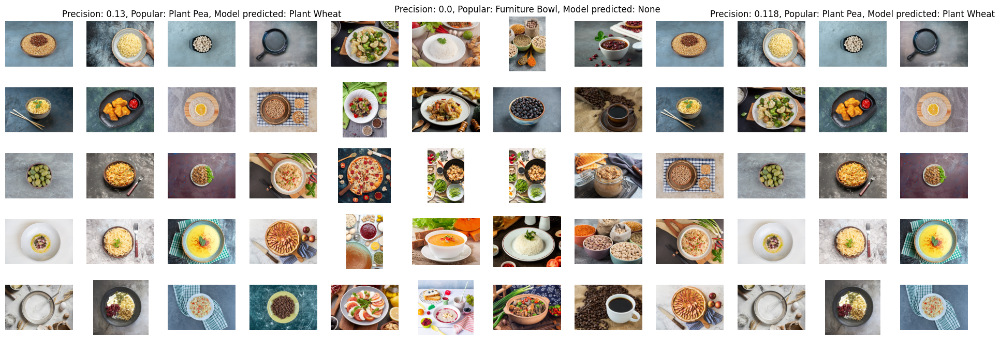

In [ ]:
search_imgWithAllOpts('query18-wheat.png', 20, vgg_penalty = 0.8)
# The results look OK!

1/1 [==============================] - 1s 510ms/step
TRAINED
1/1 [==============================] - 0s 145ms/step
VGG16
1/1 [==============================] - 0s 143ms/step
MIX: 0.8


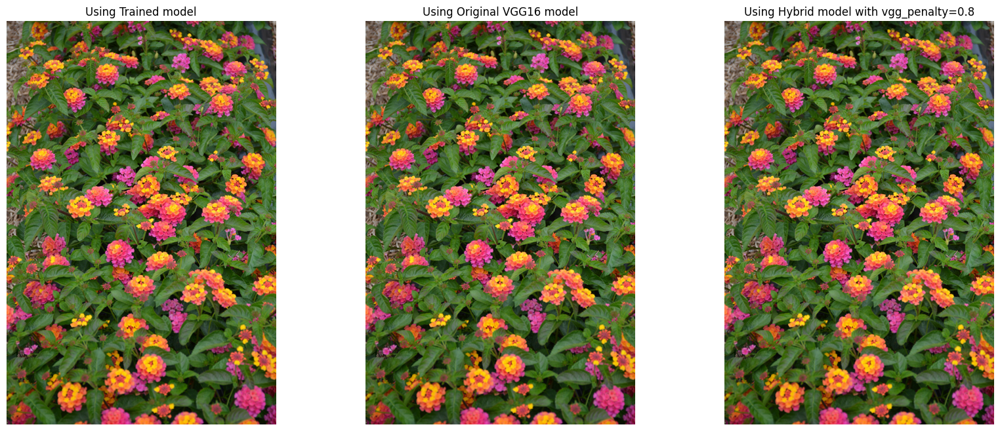

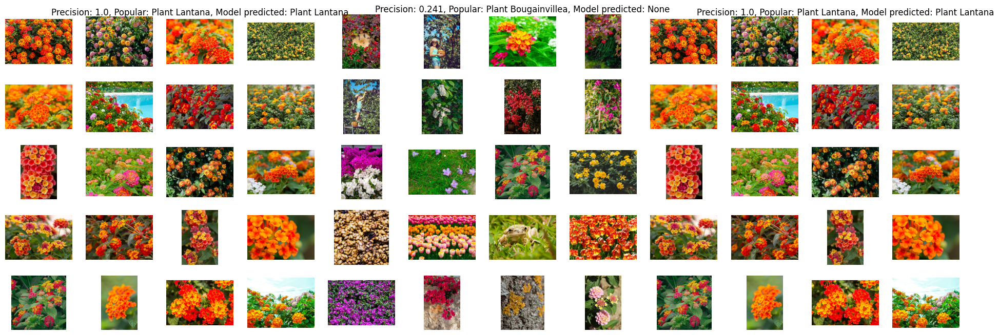

In [ ]:
search_imgWithAllOpts('query19-lantana.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 1s 882ms/step
TRAINED
1/1 [==============================] - 0s 246ms/step
VGG16
1/1 [==============================] - 0s 162ms/step
MIX: 0.8


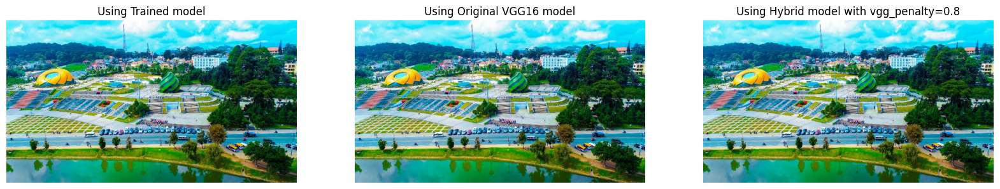

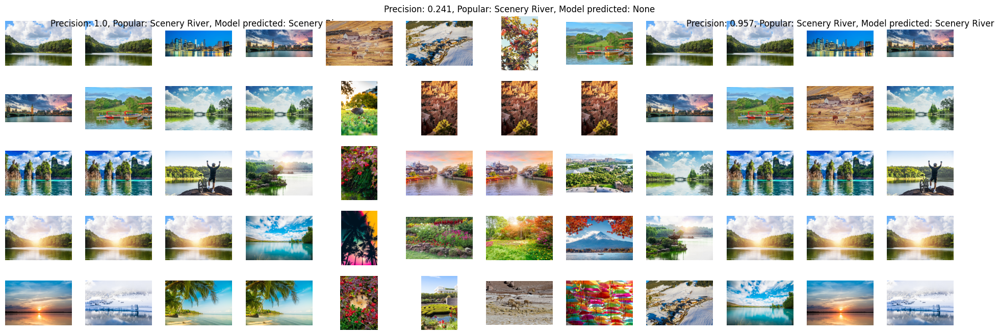

In [ ]:
search_imgWithAllOpts('query20-river.jpg', 20, vgg_penalty = 0.8)
# The results look good!

1/1 [==============================] - 0s 295ms/step
TRAINED
1/1 [==============================] - 0s 148ms/step
VGG16
1/1 [==============================] - 0s 264ms/step
MIX: 0.8


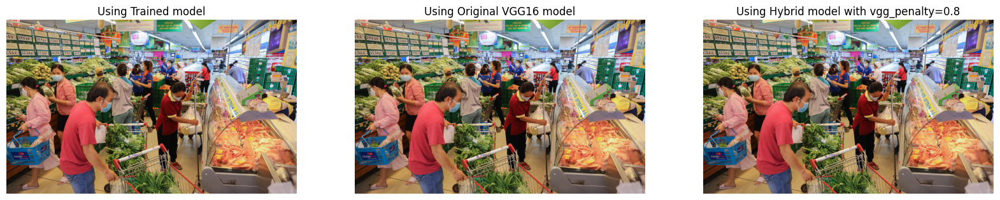

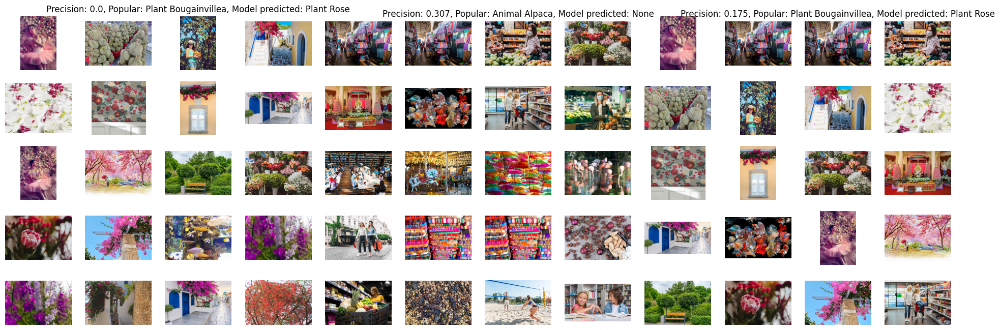

In [ ]:
search_imgWithAllOpts('query21-cart.jpg', 20, vgg_penalty = 0.8)
# The results are so-so!

# Evaluation

In [ ]:
import os

queries = [f for f in os.listdir() if 'query' in f]
queries

['query13-ants.jpg',
 'query12-umbrella.PNG',
 'query18-wheat.png',
 'query21-cart.jpg',
 'query19-lantana.jpg',
 'query15-shrimp.jpg',
 'query7-piano.jpg',
 'query8-lake.png',
 'query10-waterfall.PNG',
 'query6-fern.jpg',
 'query4-grassland.PNG',
 'query14-panda.jpg',
 'query11-waterfall.jpg',
 'query2-clock.PNG',
 'query1-alligator.png',
 'query3-apricot.PNG',
 'query16-fridge.png',
 'query20-river.jpg',
 'query17-panda.jpg',
 'query5-glacier.PNG']

In [ ]:
# Calculate Mean Average Precision (MAP)
def mean_average_precision(queries, num_imgs = 20, modelOption = ModelOption.TRAINED, vgg_penalty = 0.85):
  sum, count = 0, 0
  maps = []
  for query_path in queries:
    # Load query image from its path
    query = kimage.load_img(query_path, target_size=(86, 128))
    query_np = kimage.img_to_array(query) # Convert to array
    tps_sorted, _ = get_final_sims(query_np, num_imgs, modelOption, vgg_penalty = vgg_penalty) # Get relevants

    result_paths = get_result_paths(tps_sorted) # Get image paths of relevants images
    # Evaluate
    sum += average_precision(query_path, result_paths)
    count += 1
    maps.append(sum / count)
  return maps


def evaluate_hyper_models(queries, num_imgs = 20):
  # MAP for the Trained model
  trained_MAPs = mean_average_precision(queries, num_imgs = num_imgs, modelOption = ModelOption.TRAINED)

  # MAP for the Trained model
  vgg16_MAPs = mean_average_precision(queries, num_imgs = num_imgs, modelOption = ModelOption.VGG16)

  # Tuning different vgg_factors
  hybrid_MAPs = []
  for vgg_factor in [1.0 - i * 0.05 for i in range(10)]:
    maps = mean_average_precision(queries, num_imgs = num_imgs, modelOption = ModelOption.HYBRID, vgg_penalty = vgg_factor)
    hybrid_MAPs.append((vgg_factor, maps))

  return trained_MAPs, vgg16_MAPs, hybrid_MAPs

In [ ]:
num_imgs = 20
trained_MAPs, vgg16_MAPs, hybrid_MAPs = evaluate_hyper_models(queries, num_imgs = num_imgs)

1/1 [==============================] - 0s 22ms/step
TRAINED
1/1 [==============================] - 0s 20ms/step
TRAINED
1/1 [==============================] - 0s 20ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 37ms/step
TRAINED
1/1 [==============================] - 0s 29ms/step
TRAINED
1/1 [==============================] - 0s 30ms/step
TRAINED
1/1 [==============================] - 0s 17ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 25ms/step
TRAINED
1/1 [==============================] - 0s 36ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0s 19ms/step
TRAINED
1/1 [==============================] - 0

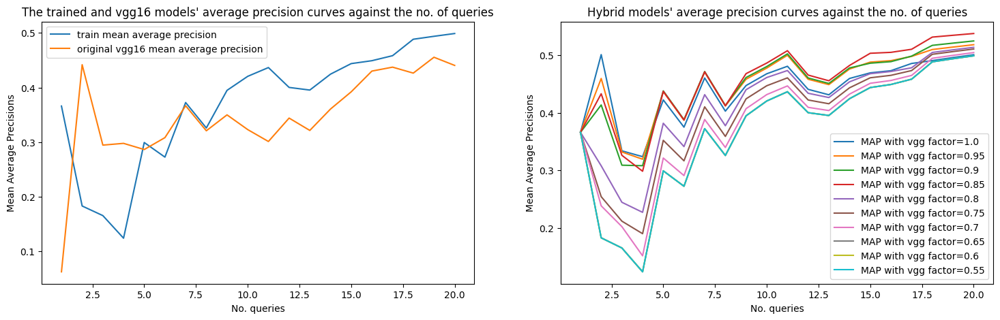

In [ ]:
import matplotlib.pyplot as plt

x = list(range(1, len(queries) + 1))
fig = plt.figure(figsize=(18, 5))
fig.add_subplot(1, 2, 1)
plt.plot(x, trained_MAPs, label = "train mean average precision")
plt.plot(x, vgg16_MAPs, label = "original vgg16 mean average precision")

plt.legend()
plt.xlabel('No. queries')
plt.ylabel('Mean Average Precisions')
plt.title('The trained and vgg16 models\' average precision curves against the no. of queries')

fig.add_subplot(1, 2, 2)
for factor, maps in hybrid_MAPs:
  plt.plot(x, maps, label = f"MAP with vgg factor={round(factor, 2)}")
plt.legend()

plt.xlabel('No. queries')
plt.ylabel('Mean Average Precisions')
plt.title('Hybrid models\' average precision curves against the no. of queries')

plt.show()